# Data-Exploration

## Imports

In [12]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

from os.path import join
from sklearn.manifold import TSNE

import data_helper

## Data

### Sample of raw data

In [2]:
pd.read_csv(join("csv","raw","data0.csv")).head()

,Unnamed: 0,result,table,_start,_stop,_time,_measurement,label,mobile,subject,alpha,beta,gamma,x,y,z
0,0,_result,0,2021-01-01 00:00:00+00:00,2021-10-04 16:16:00.738177+00:00,2021-04-26 17:23:45.939000+00:00,devicemotion,sitting,Pixel,10a76,-16.3,-8.5,5.7,0.1,6.2,8.2
1,1,_result,0,2021-01-01 00:00:00+00:00,2021-10-04 16:16:00.738177+00:00,2021-04-26 17:23:45.955000+00:00,devicemotion,sitting,Pixel,10a76,-11.1,-7.5,1.9,-0.1,6.0,8.4
2,2,_result,0,2021-01-01 00:00:00+00:00,2021-10-04 16:16:00.738177+00:00,2021-04-26 17:23:45.972000+00:00,devicemotion,sitting,Pixel,10a76,-5.3,-6.1,0.5,0.0,6.1,8.3
3,3,_result,0,2021-01-01 00:00:00+00:00,2021-10-04 16:16:00.738177+00:00,2021-04-26 17:23:45.988000+00:00,devicemotion,sitting,Pixel,10a76,-3.3,-2.0,-1.7,0.0,6.1,8.2
4,4,_result,0,2021-01-01 00:00:00+00:00,2021-10-04 16:16:00.738177+00:00,2021-04-26 17:23:46.005000+00:00,devicemotion,sitting,Pixel,10a76,-3.1,2.3,-4.3,-0.2,5.9,8.0


### Preprocess data (with windowing and feature generation)

The following aggregation functions are beeing used on 1s windows:
- min
- max
- mean
- median
- std
- var

In [3]:
data = data_helper.prepare_data()
df = data_helper.aggregate(data)
df.head()

,alpha_min,alpha_max,alpha_mean,alpha_median,alpha_std,alpha_var,beta_min,beta_max,beta_mean,beta_median,...,y_std,y_var,z_min,z_max,z_mean,z_median,z_std,z_var,label,subject
0,-16.3,-3.3,-9.000000,-8.20,5.884443,34.626667,-8.5,-2.0,-6.025000,-6.80,...,0.081650,0.006667,8.2,8.4,8.275000,8.25,0.095743,0.009167,sitting,0
1,-13.5,6.0,-1.138333,-0.35,4.726488,22.339692,-14.8,2.5,-2.761667,-1.75,...,0.103539,0.010720,7.5,8.4,7.913333,7.90,0.204580,0.041853,sitting,0
2,-22.0,28.9,5.650000,5.35,8.638493,74.623559,-8.8,44.8,4.875000,2.00,...,0.362240,0.131218,5.2,8.3,7.528333,7.80,0.764042,0.583760,sitting,0
3,-65.5,125.6,-3.998333,-16.20,41.812728,1748.304234,-30.7,41.5,0.488333,-4.65,...,1.419727,2.015624,3.3,14.3,7.846667,6.80,3.121574,9.744226,sitting,0
4,-21.5,29.5,2.386667,-5.05,17.077217,291.631345,-17.4,8.8,-3.530000,-1.30,...,0.392212,0.153831,5.6,8.1,6.698333,6.75,0.653411,0.426946,sitting,0


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2541 entries, 0 to 2540
Data columns (total 38 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   alpha_min     2541 non-null   float64
 1   alpha_max     2541 non-null   float64
 2   alpha_mean    2541 non-null   float64
 3   alpha_median  2541 non-null   float64
 4   alpha_std     2541 non-null   float64
 5   alpha_var     2541 non-null   float64
 6   beta_min      2541 non-null   float64
 7   beta_max      2541 non-null   float64
 8   beta_mean     2541 non-null   float64
 9   beta_median   2541 non-null   float64
 10  beta_std      2541 non-null   float64
 11  beta_var      2541 non-null   float64
 12  gamma_min     2541 non-null   float64
 13  gamma_max     2541 non-null   float64
 14  gamma_mean    2541 non-null   float64
 15  gamma_median  2541 non-null   float64
 16  gamma_std     2541 non-null   float64
 17  gamma_var     2541 non-null   float64
 18  x_min         2541 non-null 

In [5]:
df.columns

Index(['alpha_min', 'alpha_max', 'alpha_mean', 'alpha_median', 'alpha_std',
       'alpha_var', 'beta_min', 'beta_max', 'beta_mean', 'beta_median',
       'beta_std', 'beta_var', 'gamma_min', 'gamma_max', 'gamma_mean',
       'gamma_median', 'gamma_std', 'gamma_var', 'x_min', 'x_max', 'x_mean',
       'x_median', 'x_std', 'x_var', 'y_min', 'y_max', 'y_mean', 'y_median',
       'y_std', 'y_var', 'z_min', 'z_max', 'z_mean', 'z_median', 'z_std',
       'z_var', 'label', 'subject'],
      dtype='object')

In [15]:
df.isna().values.sum()

0

In [6]:
# Create a DataFrame without the subject column
df2 = df.drop(columns="subject")

#### Plots

##### Countplot

<AxesSubplot:xlabel='label', ylabel='count'>

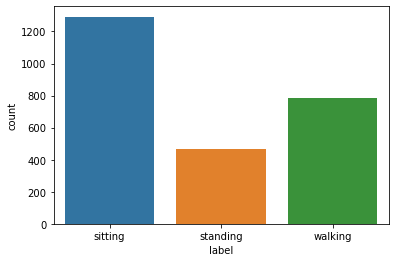

In [7]:
sns.countplot(x="label", data=df2)

##### Boxplots

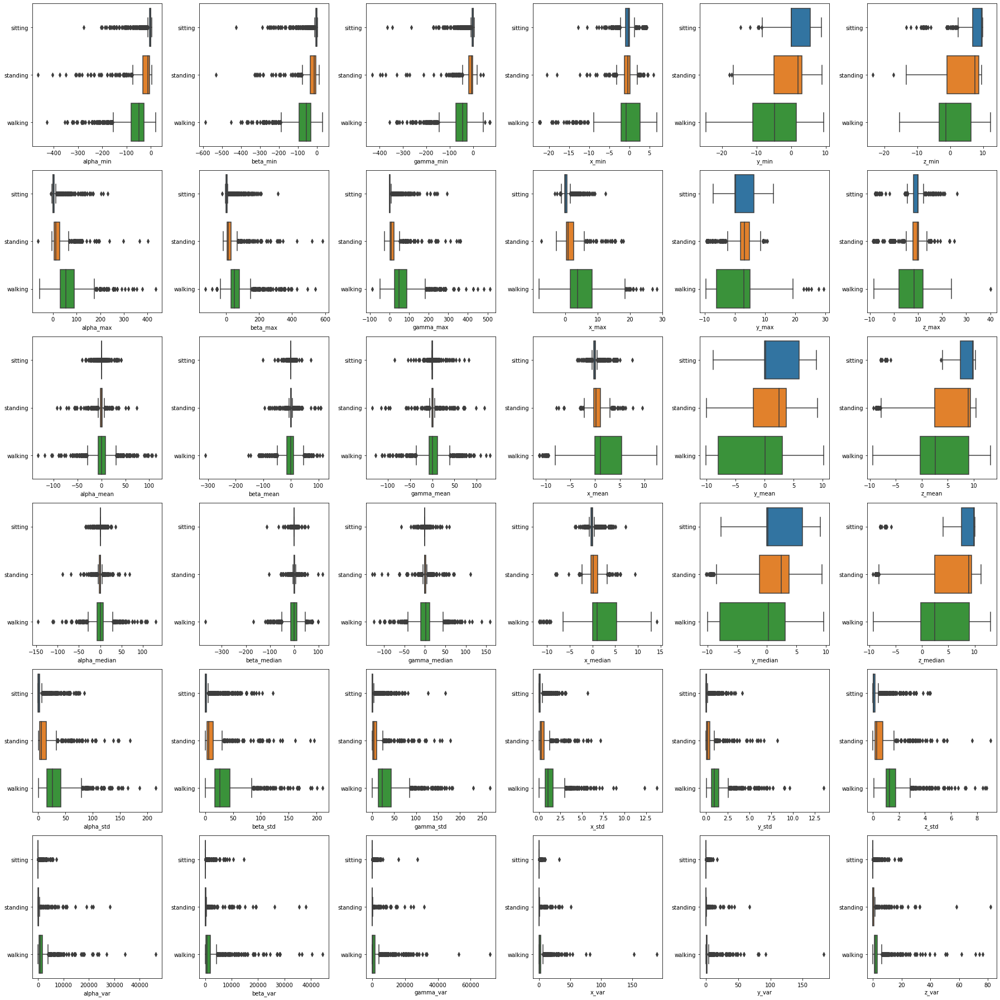

In [8]:
agg_col = df.columns[:-2]
num_agg = len(data_helper.aggregation)
f, ax = plt.subplots(num_agg, int(len(agg_col) / num_agg), figsize=(25,25))
for idx, c in enumerate(agg_col):
    ax_c = ax[idx % num_agg, int(idx/num_agg)]
    sns.boxplot(x=c, y="label", data=df, ax= ax_c)

    # settings for axes
    ax_c.set(ylabel="")

#Many plots therefore tightlayout
plt.tight_layout()

##### Heatmap

Beware that there is no scaling for the data at this moment. To get better training results scaling to the same ranges should be used.

<AxesSubplot:>

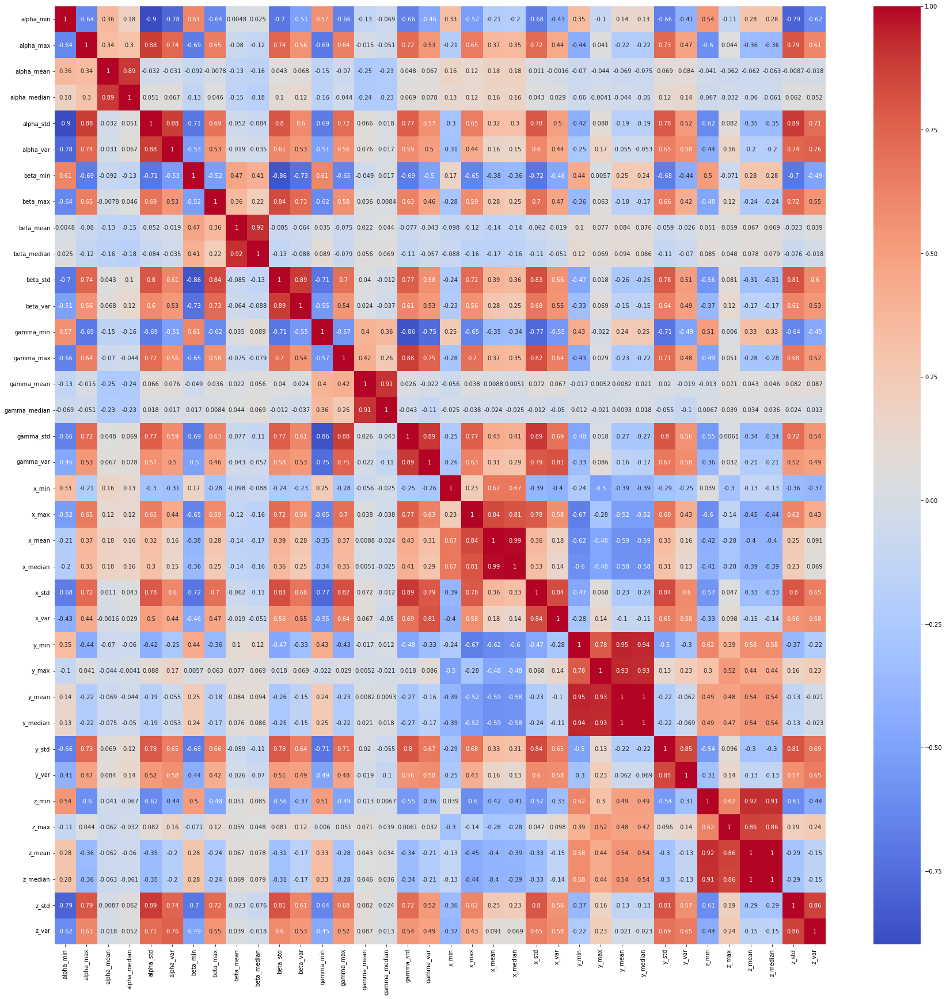

In [9]:
plt.figure(figsize=(30,30))
sns.heatmap(df2.corr(), annot=True, cmap='coolwarm')

##### Pairplot

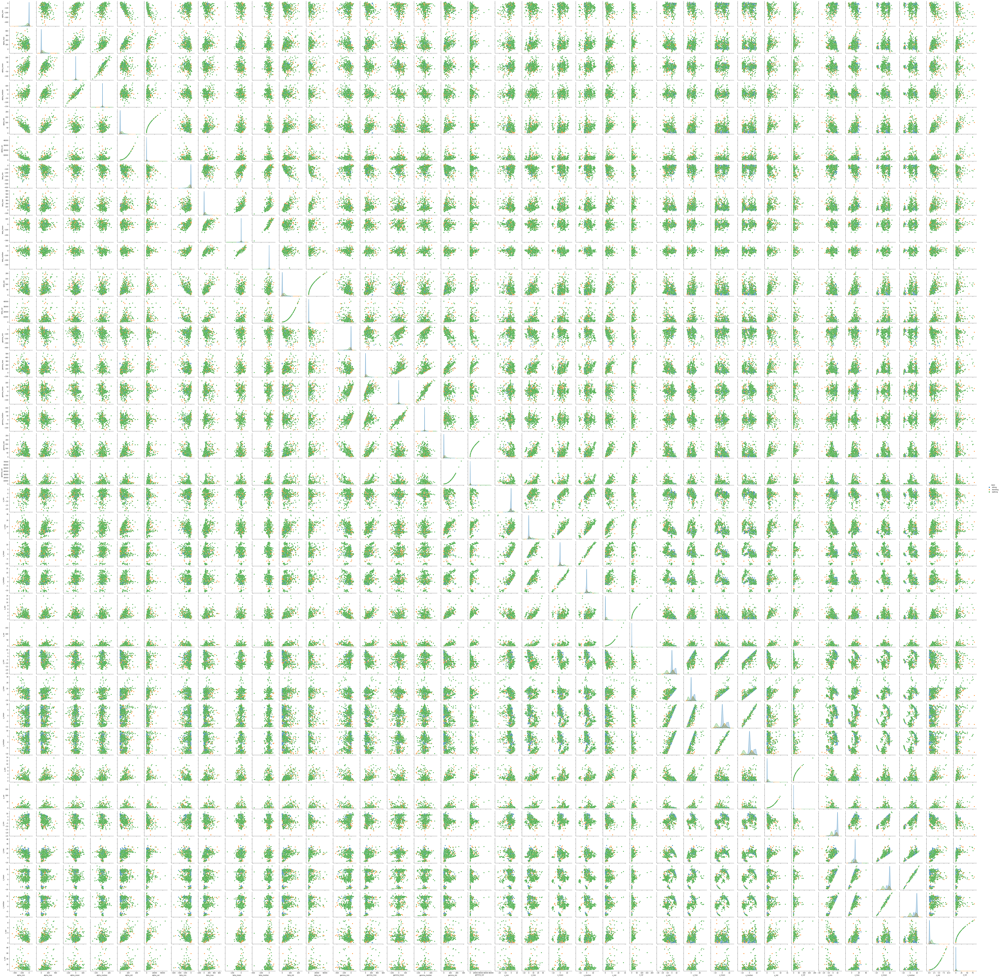

In [10]:
plt.figure(figsize=(30,30))
sns.pairplot(data=df2, hue="label")

##### Scatterplots

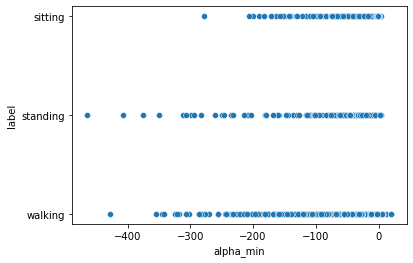

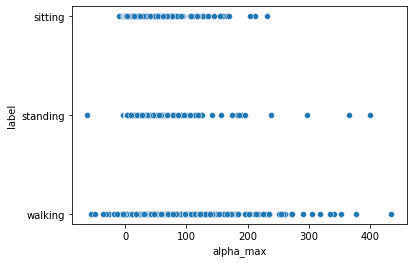

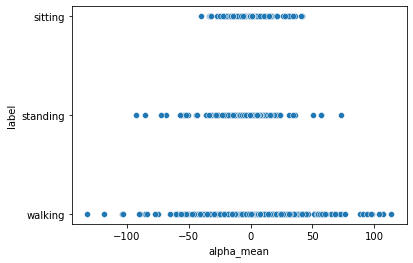

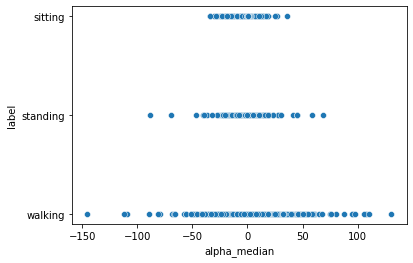

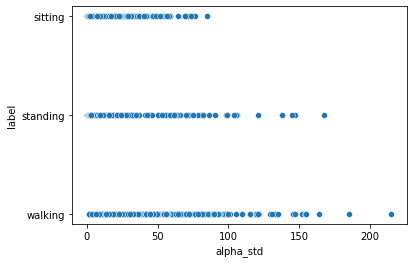

...

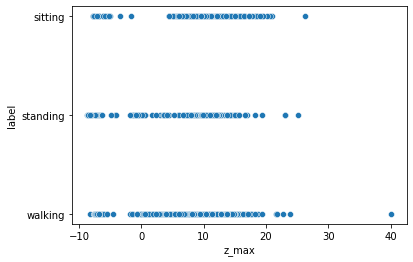

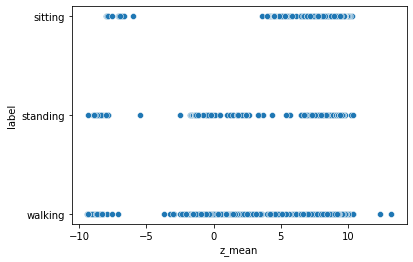

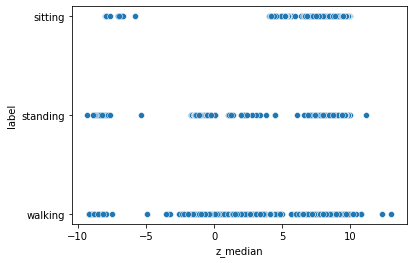

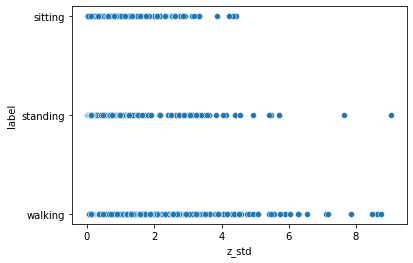

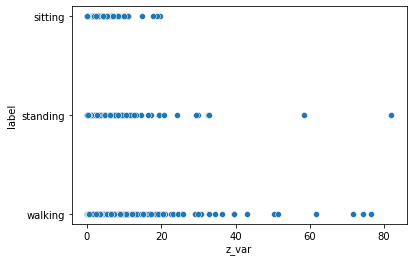

In [11]:
for col in df2.columns[:-1]:
    plot = sns.scatterplot(data=df2, x=col, y="label")
    plt.show()

##### t-SNE

C:\Users\Anwender\anaconda3\envs\KSS_python\lib\site-packages\sklearn\manifold\_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
C:\Users\Anwender\anaconda3\envs\KSS_python\lib\site-packages\sklearn\manifold\_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
C:\Users\Anwender\AppData\Local\Temp/ipykernel_5908/3338492335.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tsne["x"] = tsne_features[:,0]
C:\Users\Anwender\AppData\Local\Temp/ipykernel_5908/3338492335.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = va

<AxesSubplot:xlabel='x', ylabel='y'>

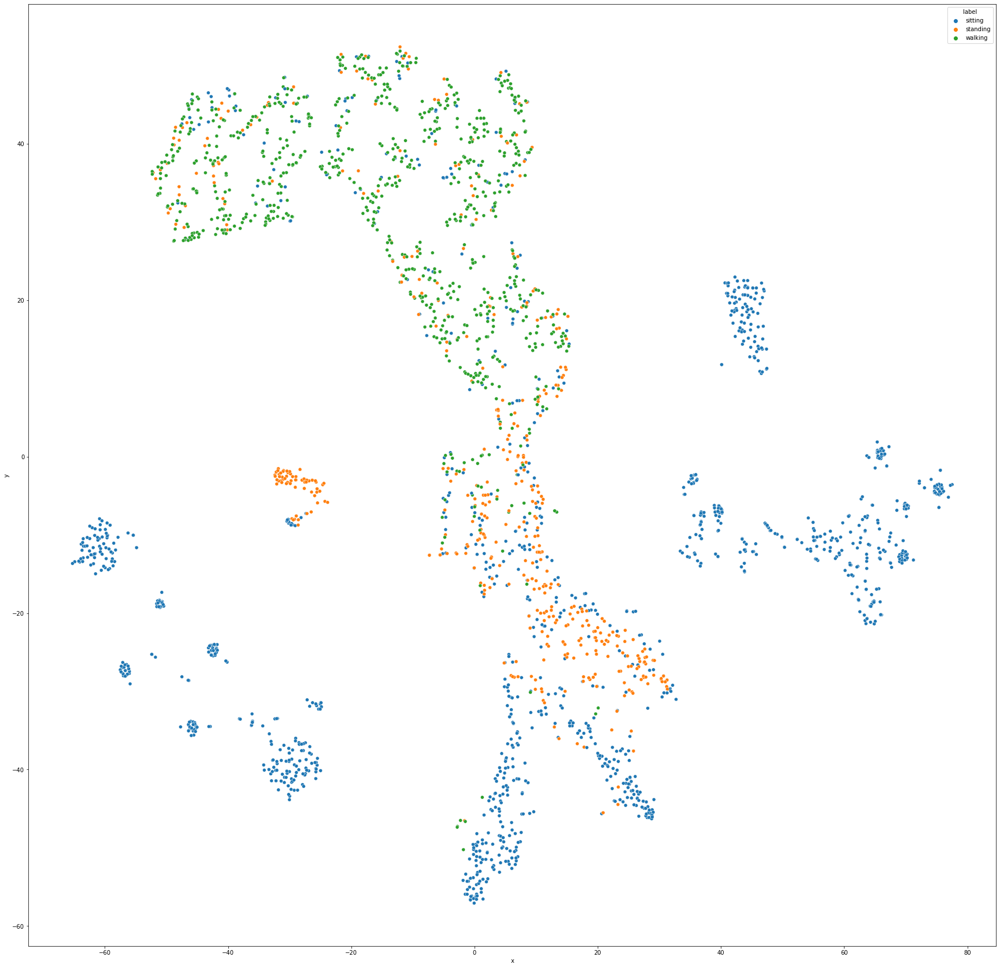

In [14]:
plt.figure(figsize=(30,30))

m = TSNE(n_components=2)
tsne_features = m.fit_transform(df2.drop(columns="label"))
tsne = df2[["label"]]
tsne["x"] = tsne_features[:,0]
tsne["y"] = tsne_features[:,1]

sns.scatterplot(x="x", y="y", hue="label", data=tsne)